In [25]:
# Needed imports.
import numpy as np
import pandas as pd
import anndata as ad
import umap
import plotly.graph_objects as go

In [26]:
from sklearn.preprocessing import StandardScaler

# Read bx1, bx2 datasets.
bx1_file = "HTAN2_HMS_0000330944_bx1_OCT_tumor_cycif.csv"
bx2_file = "HTAN2_HMS_0000330954_bx2_OCT_tumor_cycif.csv"
bx1_df = pd.read_csv(bx1_file, header=0)
bx1_df['bx'] = 1
bx1_df['scaled'] = 'N'
bx2_df = pd.read_csv(bx2_file, header=0)
bx2_df['bx'] = 2
bx2_df['scaled'] = 'N'
bx2_df.head()

# Scale markers for each dataset independently. Scale approach:
# 1. log10 transformation
# 2. standard scaling
# 3. clip to maximum range
scaler = StandardScaler()
scale_func = lambda d: scaler.fit_transform(d).clip(min=-10, max=10)

# Scale only the marker columns.
marker_cols = bx1_df.filter(regex="Cell Masks$").filter(regex="^(?!(Goat|DAPI))").columns
bx1_df_scaled = bx1_df.copy()
bx1_df_scaled[marker_cols] = scale_func(bx1_df[marker_cols])
bx1_df_scaled['scaled'] = 'Y'
bx2_df_scaled = bx2_df.copy()
bx2_df_scaled[marker_cols] = scale_func(bx2_df[marker_cols])
bx2_df_scaled['scaled'] = 'Y'

# Combine unscaled and scaled data to create complete dataset.
cycif_df = pd.concat([bx1_df, bx2_df, bx1_df_scaled, bx2_df_scaled])
cycif_df.reset_index(inplace=True)
cycif_df.tail()

# Create spartial df
cycif_spatial_df = cycif_df[['index', 'X_centroid','Y_centroid']]

In [27]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create plots of scaled, unscaled data for a single marker.
marker = "CK-19_Cell Masks"
fig = make_subplots(rows=1, cols=2)
df = cycif_df[cycif_df['scaled'] == 'N']
fig.add_trace(go.Violin(y=df[df['bx'] == 1][marker], x=df[df['bx'] == 1]['bx'], box_visible=True), row=1, col=1)
fig.add_trace(go.Violin(y=df[df['bx'] == 2][marker], x=df[df['bx'] == 2]['bx'], box_visible=True), row=1, col=1)

df = cycif_df[cycif_df['scaled'] == 'Y']
fig.add_trace(go.Violin(y=df[df['bx'] == 1][marker], x=df[df['bx'] == 1]['bx'], box_visible=True), row=1, col=2)
fig.add_trace(go.Violin(y=df[df['bx'] == 2][marker], x=df[df['bx'] == 2]['bx'], box_visible=True), row=1, col=2)

# Create single faceted plot:
# df = cycif_df
# fig = px.violin(df, y="CK-19_Cell Masks", x="bx", color="scaled", hover_data=df.columns)
# fig.show()


In [28]:
# Produce a violin plot for all markers with scaled data. NOTE: this is slow.
def violin_plot_cols(df):
    """ Violin plot for all columns in a data frame. """
    fig = go.Figure()

    for col in df.columns:
        fig.add_trace(go.Violin(y=df[col],
                                name=col))
    fig.show()

violin_plot_cols(cycif_df[cycif_df.scaled == 'Y'][marker_cols])

In [29]:
# Only work with scaled data from here.
cycif_scaled_df = cycif_df[cycif_df.scaled == 'Y']
markers_df = cycif_scaled_df[marker_cols].reset_index(drop=True)
print(markers_df)
# Create UMAP representation using scaled markers.
fit = umap.UMAP()

       ERK-1_Cell Masks  CD3_Cell Masks  RAD51_Cell Masks  \
0             -0.710483       -0.758041         -0.541172   
1             -1.302372       -1.100494         -1.382007   
2             -1.122303       -1.032861         -1.409301   
3             -1.194787       -1.052083         -1.355041   
4             -0.960454       -0.926724         -1.086219   
...                 ...             ...               ...   
23169         -1.172023       -0.345317          0.115274   
23170         -1.401858       -0.890492         -0.870977   
23171         -1.178507       -0.850804         -0.677900   
23172         -1.091150       -1.090851         -1.898419   
23173         -1.220611        0.615113         -1.174184   

       CyclinD1_Cell Masks  ER-alpha_Cell Masks  alpha-SMA_Cell Masks  \
0                -0.513530            -0.788604             -0.556691   
1                -0.984219            -1.012532             -0.630601   
2                -0.833763            -0.465594 

In [30]:
# Run phenograph using scaled markers.
import phenograph

k = 30 # choose k
communities, graph, Q = phenograph.cluster(markers_df, k=k) # run PhenoGraph

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 11.054683685302734 seconds
Jaccard graph constructed in 2.6077849864959717 seconds
Wrote graph to binary file in 1.8253099918365479 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.854686
After 3 runs, maximum modularity is Q = 0.856281
Louvain completed 23 runs in 8.904904842376709 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 25.189347982406616 seconds


In [31]:
# Create and write ANNData object.
X = markers_df
obs = pd.DataFrame(index=X.index)
var = pd.DataFrame(index=list(X.columns))
obsm = {"X_umap" : u}
uns = dict()

# Note: for some reason pd.Categorical is required to get cellxgene to display the attribute.
obs['PhenoGraph_clusters'] = pd.Categorical(communities)
obs['biopsy'] = pd.Categorical(cycif_scaled_df['bx'])
obs['X_centroid'] = cycif_df.iloc[X.index]['X_centroid']
obs['Y_centroid'] = cycif_df.iloc[X.index]['Y_centroid']
uns['PhenoGraph_Q'] = Q
uns['PhenoGraph_k'] = k
adata = ad.AnnData(X.to_numpy(), obs=obs, var=var, obsm=obsm, uns=uns)
adata.write('./my_results.h5ad')

# Once written, can launch cellxgene from command line:
# > cellxgene launch my_results.h5ad

/Users/raphael/Development/OHSU/MarkerIntensityPredictor/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning:

Transforming to str index.



In [32]:
# Create heatmap showing mean marker values for each phenograph community.
import plotly.express as px

pg_clusters = pd.Series(communities)
means = []
for i in range(0, pd.Series(communities).max() + 1):
    cells_index = pg_clusters[pg_clusters == i].index
    filtered_markers_df = markers_df[markers_df.index.isin(cells_index)]
    means.append(filtered_markers_df.mean().values)

fig = px.imshow(means, x=markers_df.columns)
fig.show()

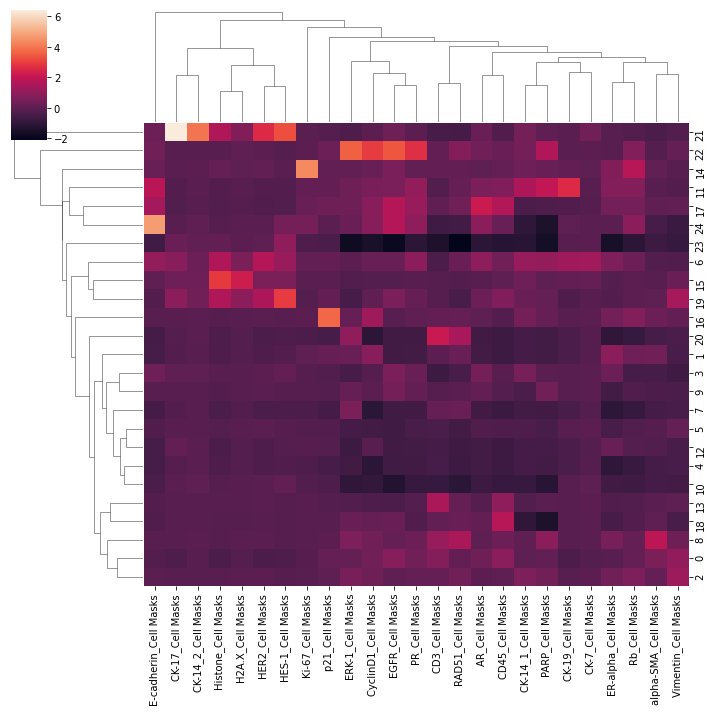

In [33]:
# Created clustered heatmap of phenograph communities.
import seaborn
df = pd.DataFrame(means, columns=markers_df.columns)
seaborn.clustermap(df)

In [34]:
# Print out highest and lowest mean marker values for each phenograph community.
for i, community in df.iterrows():
    print (i, "***")
    print(community.sort_values(ascending=False).head(3))
    print(community.sort_values(ascending=False).tail(3))

0 ***
Vimentin_Cell Masks    1.024301
CD45_Cell Masks        0.927756
EGFR_Cell Masks        0.794360
Name: 0, dtype: float64
CK-19_Cell Masks     -0.361565
HER2_Cell Masks      -0.365862
Histone_Cell Masks   -0.385096
Name: 0, dtype: float64
1 ***
ER-alpha_Cell Masks     0.938144
CyclinD1_Cell Masks     0.824714
alpha-SMA_Cell Masks    0.357342
Name: 1, dtype: float64
PR_Cell Masks     -0.578490
EGFR_Cell Masks   -0.605875
CD45_Cell Masks   -0.697589
Name: 1, dtype: float64
2 ***
Vimentin_Cell Masks    1.230057
CK-14_1_Cell Masks     0.640245
Rb_Cell Masks          0.637480
Name: 2, dtype: float64
Ki-67_Cell Masks     -0.128897
Histone_Cell Masks   -0.137369
HES-1_Cell Masks     -0.163249
Name: 2, dtype: float64
3 ***
EGFR_Cell Masks       0.559200
CK-14_1_Cell Masks    0.491214
AR_Cell Masks         0.465099
Name: 3, dtype: float64
Rb_Cell Masks         -0.510847
Vimentin_Cell Masks   -0.649651
CD3_Cell Masks        -0.743923
Name: 3, dtype: float64
4 ***
CK-14_2_Cell Masks   -0.0646